# Descarga de dataset

In [1]:
import gdown
import zipfile
import os

import numpy as np
import pandas as pd

import cv2
import matplotlib.pyplot as plt

!pip install ultralytics
from ultralytics import YOLO

import random
random.seed(123)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.3/881.3 kB 37.9 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [2]:
# Descargar el archivo desde Google Drive
file_id_train = '1CfmoYVoReTBciCvEY9PChq-H0MpPTccN'
gdown.download(f'https://drive.google.com/uc?id={file_id_train}', 'VisDrone2019-DET-train.zip', quiet=False)

# Descomprimir el archivo
with zipfile.ZipFile("VisDrone2019-DET-train.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")

# Eliminar el archivo zip después de la extracción
os.remove("VisDrone2019-DET-train.zip")


Downloading...
From (original): https://drive.google.com/uc?id=1CfmoYVoReTBciCvEY9PChq-H0MpPTccN
From (redirected): https://drive.google.com/uc?id=1CfmoYVoReTBciCvEY9PChq-H0MpPTccN&confirm=t&uuid=a995a254-c887-4e4f-8150-4cdc08685928
To: /content/VisDrone2019-DET-train.zip
100%|██████████| 1.55G/1.55G [00:18<00:00, 82.9MB/s]


In [3]:
# Se descargan datos (guardados en drive propio) de entrenamiento y validación de Visdrone
'''
!gdown --id 1CfmoYVoReTBciCvEY9PChq-H0MpPTccN #1a2oHjcEcwXP8oUF95qiwrqzACb2YlUhn
with zipfile.ZipFile("VisDrone2019-DET-train.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")
os.remove("VisDrone2019-DET-train.zip")

!gdown --id 1bxK5zgLn0_L8x276eKkuYA_FzwCIjb59
with zipfile.ZipFile("VisDrone2019-DET-val.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")
os.remove("VisDrone2019-DET-val.zip")
'''
file_id_val = '1BxxRDPHMkchfopDHTbjGpBkBg3EhkHwJ'
gdown.download(f'https://drive.google.com/uc?id={file_id_val}', 'VisDrone2019-DET-val.zip', quiet=False)

# Descomprimir el archivo
with zipfile.ZipFile("VisDrone2019-DET-val.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")

# Eliminar el archivo zip después de la extracción
os.remove("VisDrone2019-DET-val.zip")



Downloading...
From (original): https://drive.google.com/uc?id=1BxxRDPHMkchfopDHTbjGpBkBg3EhkHwJ
From (redirected): https://drive.google.com/uc?id=1BxxRDPHMkchfopDHTbjGpBkBg3EhkHwJ&confirm=t&uuid=46c9c391-6298-4400-8da1-472d86edc12c
To: /content/VisDrone2019-DET-val.zip
100%|██████████| 81.6M/81.6M [00:00<00:00, 130MB/s]


El dataset VisDrone utiliza un formato de anotación específico para describir la ubicación y el tipo de objetos presentes en las imágenes. Cada anotación se almacena en un archivo .txt correspondiente a cada imagen, que contiene la siguiente información:

- **x1, y1, x2, y2:**  Coordenadas del cuadro delimitador (bounding box) del objeto, donde (x1, y1) es la esquina superior izquierda y (x2, y2) la esquina inferior derecha.
- **object_id:** Identificador numérico del tipo de objeto detectado.  
- **occluded:** Indica si el objeto está ocluido (0: no ocluido, 1: ocluido).
- **truncated:** Indica si el objeto está truncado (0: no truncado, 1: truncado).

Estas anotaciones serán convertidas a un formato más compatible, en este caso Yolo, mediante el script obtenido del siguiente archivo ofrecido por Ultralytics:

https://raw.githubusercontent.com/ultralytics/yolov5/master/data/VisDrone.yaml

Se utilizará este formato como base y luego, dependiendo del modelo a entrenar, se realizarán nuevas conversiones en caso de ser necesario.

In [4]:
def visdrone2yolo(dir):
    from PIL import Image
    from tqdm import tqdm

    def convert_box(size, box):
        # Convert VisDrone box to YOLO xywh box
        dw = 1. / size[0]
        dh = 1. / size[1]
        return (box[0] + box[2] / 2) * dw, (box[1] + box[3] / 2) * dh, box[2] * dw, box[3] * dh

    (dir / 'labels').mkdir(parents=True, exist_ok=True)  # make labels directory
    pbar = tqdm((dir / 'annotations').glob('*.txt'), desc=f'Converting {dir}')
    for f in pbar:
        img_size = Image.open((dir / 'images' / f.name).with_suffix('.jpg')).size
        lines = []
        with open(f, 'r') as file:  # read annotation.txt
            for row in [x.split(',') for x in file.read().strip().splitlines()]:
                if row[4] == '0':  # VisDrone 'ignored regions' class 0
                    continue
                cls = int(row[5]) - 1
                box = convert_box(img_size, tuple(map(int, row[:4])))
                lines.append(f"{cls} {' '.join(f'{x:.6f}' for x in box)}\n")
                with open(str(f).replace(os.sep + 'annotations' + os.sep, os.sep + 'labels' + os.sep), 'w') as fl:
                    fl.writelines(lines)  # write label.txt

In [5]:
from pathlib import Path

train_dir = Path('/content/VisDrone2019-DET-train')
val_dir = Path('/content/VisDrone2019-DET-val')

visdrone2yolo(train_dir)
visdrone2yolo(val_dir)


Converting /content/VisDrone2019-DET-train: 6471it [00:54, 119.53it/s]
Converting /content/VisDrone2019-DET-val: 548it [00:05, 109.39it/s]


In [6]:
%%writefile label_map.txt
0 pedestrian
1 people
2 bicycle
3 car
4 van
5 truck
6 tricycle
7 awning-tricycle
8 bus
9 motor

Writing label_map.txt


In [7]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone2019-DET-train/images'
labels_dir_train = 'VisDrone2019-DET-train/labels'

images_dir_val = 'VisDrone2019-DET-val/images'
labels_dir_val = 'VisDrone2019-DET-val/labels'

# Análisis de datos

## Código de las clases

In [8]:
file_path = 'label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df = pd.DataFrame(data)
df


,label,category
0,0,pedestrian
1,1,people
2,2,bicycle
3,3,car
4,4,van
5,5,truck
6,6,tricycle
7,7,awning-tricycle
8,8,bus
9,9,motor


## Balance de clases

In [9]:
category_counts = {}
images = 0


# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

Cantidad de imagenes: 6471


In [10]:
df_merged = pd.merge(df_counts, df, on='label')

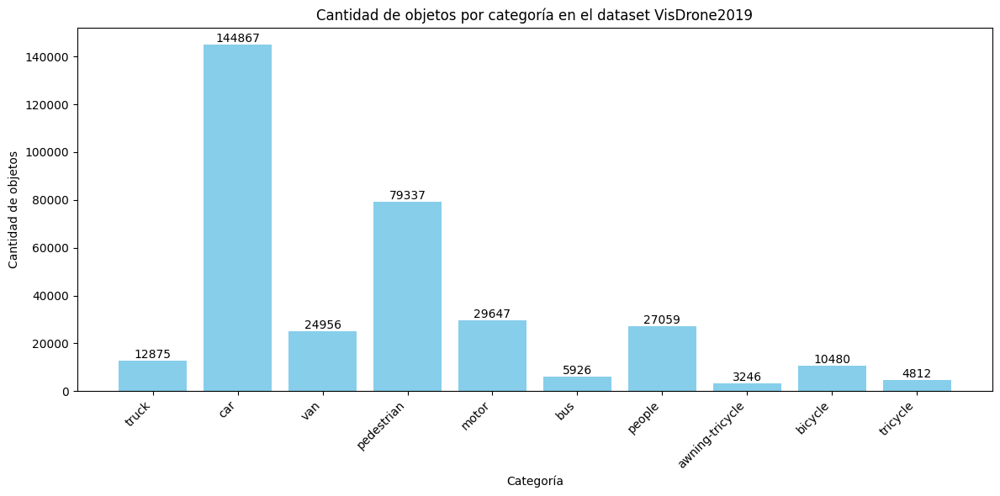

In [11]:
plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

Este gráfico permite visualizar la distribución de las clases en el dataset. Se puede ver que notoriamente la clase `car` es la que presenta mayor cantidad de detecciones, seguida por `pedestrian`. Entre las que presentan un número bastante menor se destacan `awning-tricycle`, `tricycle` y `bus`. Esto es necesario tenerlo en cuenta cuando se observen los resultados de los primeros entrenamientos. Es posible que los modelos tengan dificultades en detectar estas clases, aunque dependerá de las características particulares de las mismas y qué tan distinguibles son del resto.

## Bounding Boxes

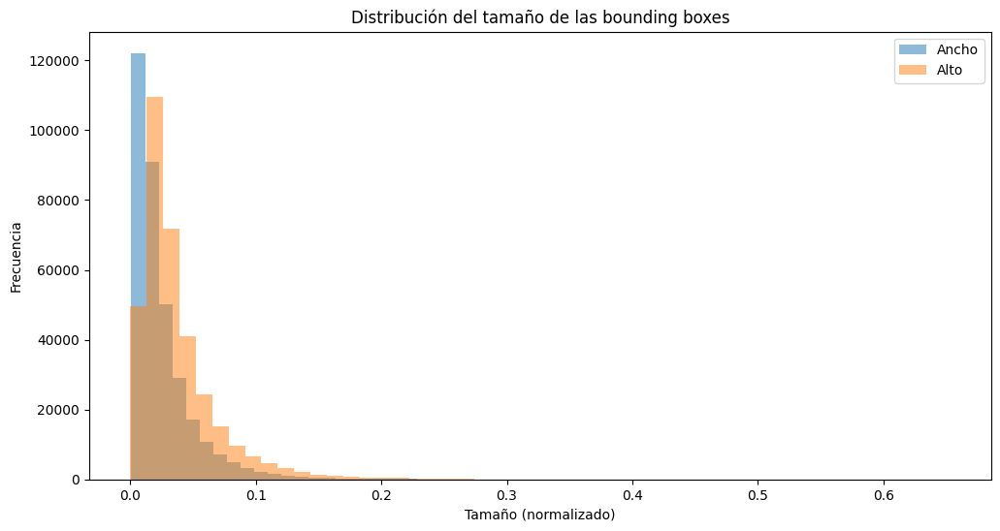

In [12]:
bbox_widths = []
bbox_heights = []

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                _, x_center, y_center, width, height, *_ = line.split()
                bbox_widths.append(float(width))
                bbox_heights.append(float(height))

plt.figure(figsize=(12, 6))
plt.hist(bbox_widths, bins=50, alpha=0.5, label='Ancho')
plt.hist(bbox_heights, bins=50, alpha=0.5, label='Alto')
plt.xlabel('Tamaño (normalizado)')
plt.ylabel('Frecuencia')
plt.title('Distribución del tamaño de las bounding boxes')
plt.legend()
plt.show()

Este gráfico muestra la distribución del ancho y alto de las *bounding boxes* del dataset. Se puede observar que la gran mayoría tiene un tamaño pequeño en relación con las dimensiones de la imagen. Tal como se mencionó anteriormente, tanto el ancho como el alto están normalizados entre 0 y 1.

El hecho de que haya *bounding boxes* tan pequeños en relación al tamaño de la imagen, sugiere que las mismas fueron tomadas a una distancia considerable de los diferentes objetivos. En este caso es normal, considerando las mismas fueron tomadas desde drones.

Esta información podría ser útil al momento del entrenamiento, ya que podría influir en el tamaño de la red y la estrategia de redimensionamiento de las imágenes.

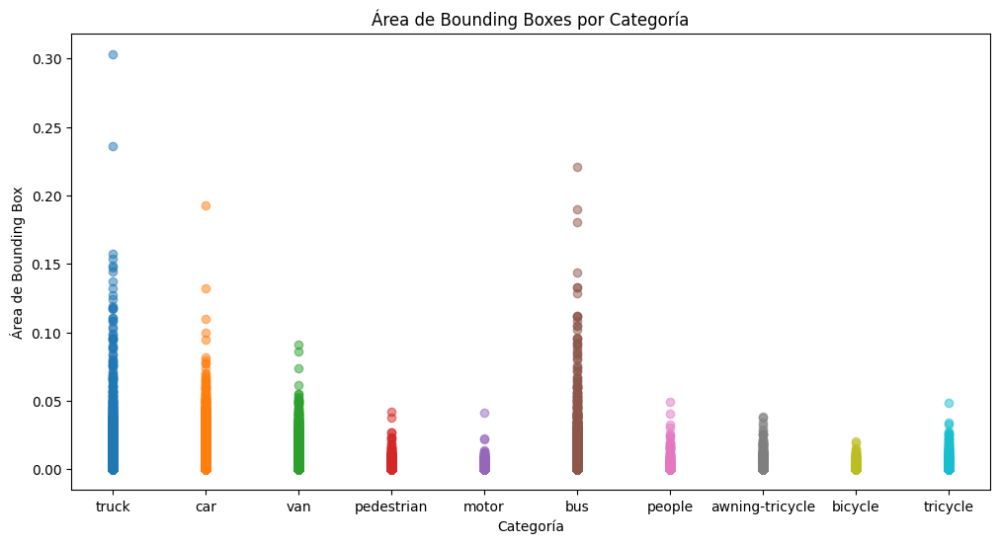

In [13]:
category_areas = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas:
                    category_areas[category] = []
                category_areas[category].append(area)

plt.figure(figsize=(12, 6))

for category, areas in category_areas.items():
  plt.scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)

plt.xlabel('Categoría')
plt.ylabel('Área de Bounding Box')
plt.title('Área de Bounding Boxes por Categoría')
#plt.legend()
plt.show()


Este gráfico muestra la distribución del área de las *bounding boxes* para cada categoría. Permite observar la variabilidad de los objetos detectados para cada clase.

Generalmente, se puede observar que los tamaños se distribuyen de acuerdo al tamaño de los objetos en la realidad. Lo que sugiere que las fotografías fueron tomadas utilizando un plano general y no enfocándose en un objeto particular.

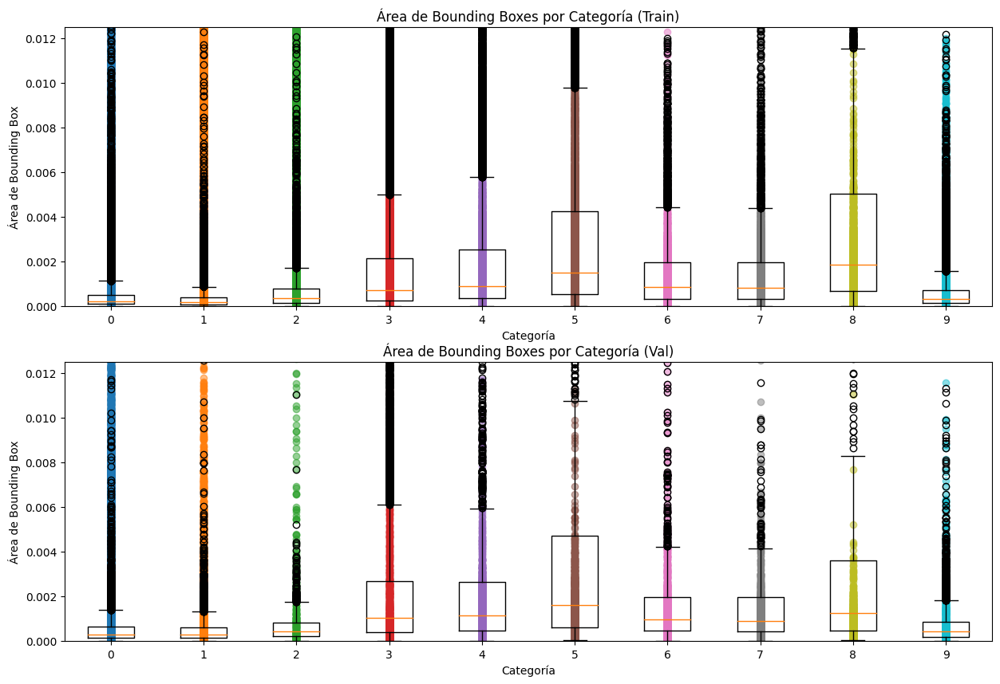

In [14]:
category_areas_train = {}
category_areas_val = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas_train:
                    category_areas_train[category] = []
                category_areas_train[category].append(area)

for filename in os.listdir(labels_dir_val):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_val, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas_val:
                    category_areas_val[category] = []
                category_areas_val[category].append(area)

fig, axs = plt.subplots(2, 1, figsize=(15, 10))

for category, areas in category_areas_train.items():
  axs[0].scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  axs[0].boxplot(areas, positions=[category], widths=0.5)

axs[0].set_xlabel('Categoría')
axs[0].set_ylabel('Área de Bounding Box')
axs[0].set_title('Área de Bounding Boxes por Categoría (Train)')
axs[0].set_ylim(0, 0.0125)

for category, areas in category_areas_val.items():
  axs[1].scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  axs[1].boxplot(areas, positions=[category], widths=0.5)

axs[1].set_xlabel('Categoría')
axs[1].set_ylabel('Área de Bounding Box')
axs[1].set_title('Área de Bounding Boxes por Categoría (Val)')
axs[1].set_ylim(0, 0.0125)

plt.show()

Se puede observar que las distribuciones mantienen su características en ambos datasets (train y validation). Las clases con mayor area corresponden a objetos de mayor tamaño (5-truck y 8-bus).

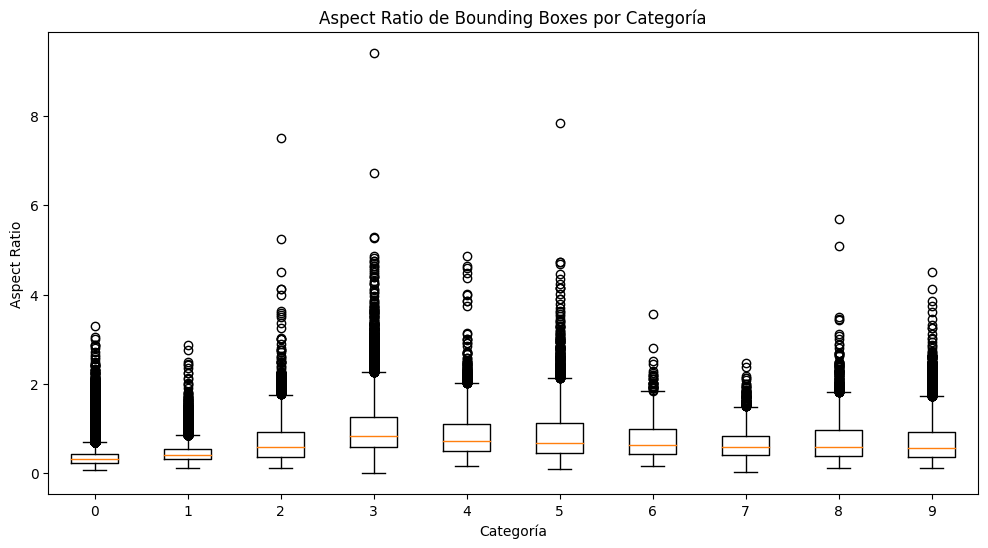

In [15]:
category_aspect_ratios = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                if float(height) == 0 or float(width) == 0:
                    aspect_ratio = 0
                else:
                    aspect_ratio = float(width) / float(height)
                if category not in category_aspect_ratios:
                    category_aspect_ratios[category] = []
                category_aspect_ratios[category].append(aspect_ratio)

plt.figure(figsize=(12, 6))

for category, aspect_ratios in category_aspect_ratios.items():
  #plt.scatter([df[df['label'] == category]['category'].values[0]] * len(aspect_ratios), aspect_ratios, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  plt.boxplot(aspect_ratios, positions=[category], widths=0.5)

plt.xlabel('Categoría')
plt.ylabel('Aspect Ratio')
plt.title('Aspect Ratio de Bounding Boxes por Categoría')
#plt.legend()
plt.show()


En este gráfico se muestra la relación entre el ancho y el alto (aspect ratio) de las bounding boxes para cada clase. Cada punto representa una bounding box y la dispersión de los mismos indica la variabilidad de las relaciones de aspecto para cada clase.

Se puede observar una gran variabilidad de relaciones de aspecto, siendo en su gran mayoría de formas aproximadamente cuadradas. Para algunas clases se observa que el valor de la media es cercano a un Aspect Ratio = 0 (width < height), sobretodo en lo que refiere a las clases 0-pedestrian y 1-people.

Esta dispersión de los puntos no indica necesariamente variaciones en los aspectos de los objetos en la realidad, si no que probablemente se debe al ángulo en que los drones capturaron las fotos.

file =  9999985_00000_d_0000020.txt line =  3 0.437857 0.150476 0.002857 0.000000



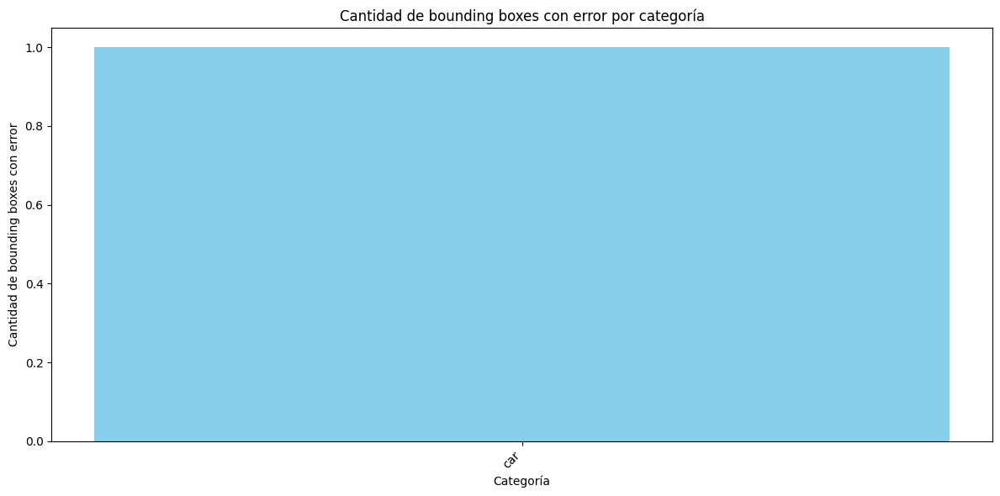

In [16]:
category_error_counts = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height = line.split()
                category = int(category)
                if float(width) <= 0 or float(height) <= 0 or float(x_center) < 0 or float(x_center) > 1 or float(y_center) < 0 or float(y_center) > 1:
                    if category not in category_error_counts:
                        category_error_counts[category] = 0
                    category_error_counts[category] += 1
                    print('file = ', filename, 'line = ', line)

# Convertir los datos a un DataFrame para facilitar el manejo
df_error_counts = pd.DataFrame(list(category_error_counts.items()), columns=['label', 'error_count'])

# Unir con el DataFrame original para obtener la categoría
df_merged_error = pd.merge(df_error_counts, df, on='label')

# Graficar la cantidad de bounding boxes con error por categoría
plt.figure(figsize=(12, 6))
plt.bar(df_merged_error['category'], df_merged_error['error_count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de bounding boxes con error')
plt.title('Cantidad de bounding boxes con error por categoría')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


Como se puede observar, hay sólo una anotación con error en el dataset en la que no se definió el alto de la bounding box. Esto no significa que el resto de las anotaciones sean perfectas, pero es una buena señal.

En las celdas siguientes se realizará una exploración visual de algunas imágenes del conjunto de entrenamiento.

# Visualización de las clases

In [17]:
def show_images_with_bboxes(image_files, images_dir, labels_dir, df):
  """
  Muestra imágenes con sus correspondientes bounding boxes.

  Args:
    image_files: Lista de nombres de archivos de imágenes.
    images_dir: Directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Cargar la imagen
      image = cv2.imread(image_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

      # Mostrar la imagen
      plt.figure(figsize=(10, 6))
      plt.imshow(image)
      plt.title(image_file)
      plt.axis('off')
      plt.show()


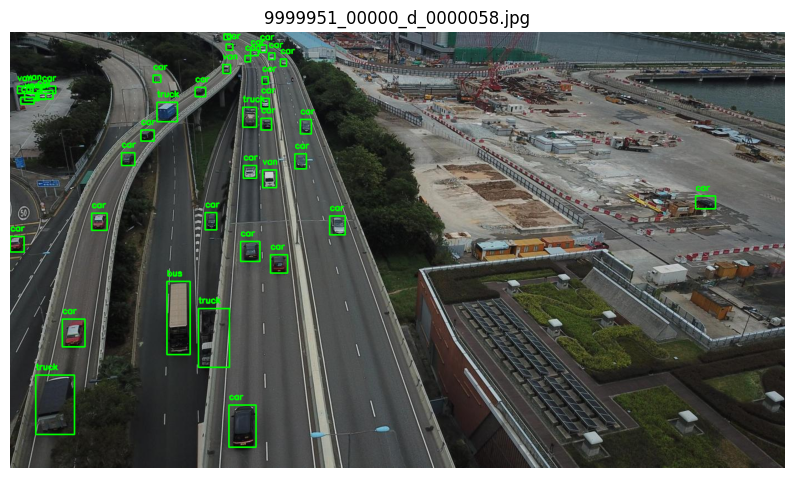

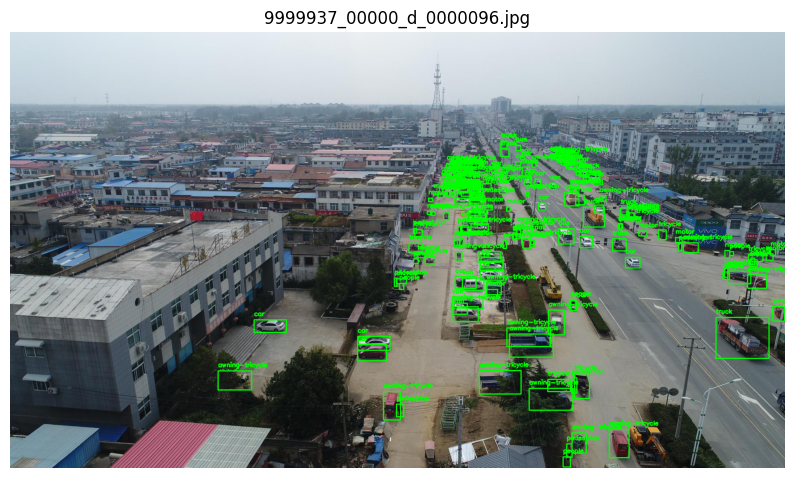

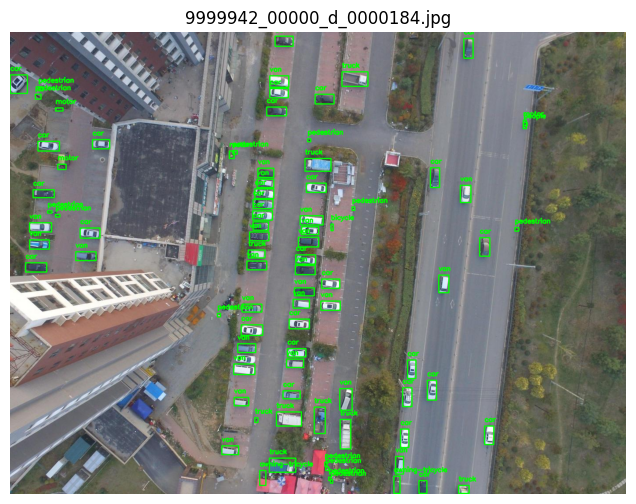

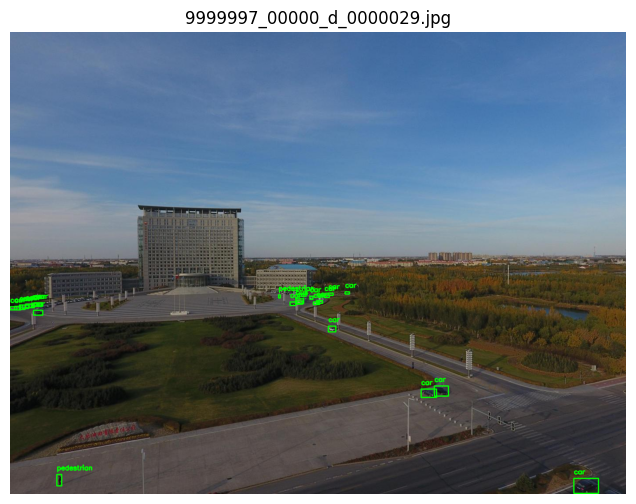

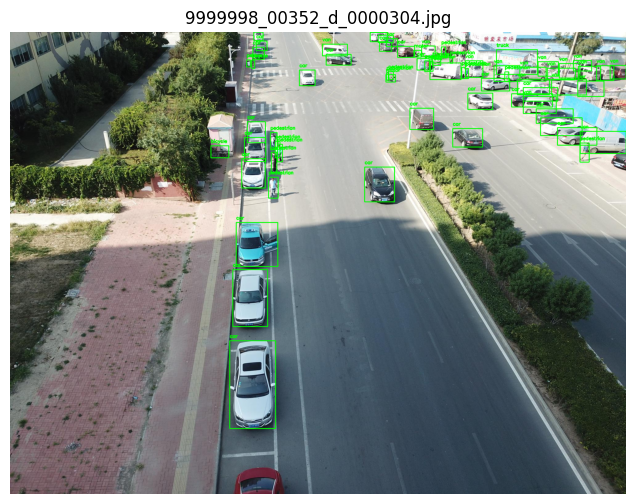

In [18]:
# Número de ejemplos a mostrar
num_examples = 5

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(images_dir_train) if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, images_dir_train, labels_dir_train, df)


In [19]:
def get_images_with_most_class(class_label, max_images=5):
  """
  Devuelve las imágenes con mayor cantidad de una clase dada.

  Args:
    class_label: Etiqueta de la clase a buscar.
    max_images: Número máximo de imágenes a devolver.

  Returns:
    Lista de nombres de archivos de imágenes con mayor cantidad de la clase.
  """
  labels_dir = 'VisDrone2019-DET-train/labels'
  class_image_counts = {}

  for filename in os.listdir(labels_dir):
      if filename.endswith('.txt'):
          with open(os.path.join(labels_dir, filename), 'r') as file:
              for line in file:
                  category, *_ = line.split()
                  category = int(category)
                  if category == class_label:  # Buscar la clase específica
                      image_name = filename.replace('.txt', '.jpg')
                      if image_name not in class_image_counts:
                          class_image_counts[image_name] = 0
                      class_image_counts[image_name] += 1

  sorted_images = sorted(class_image_counts.items(), key=lambda item: item[1], reverse=True)

  return [x[0] for x in sorted_images[:max_images]]

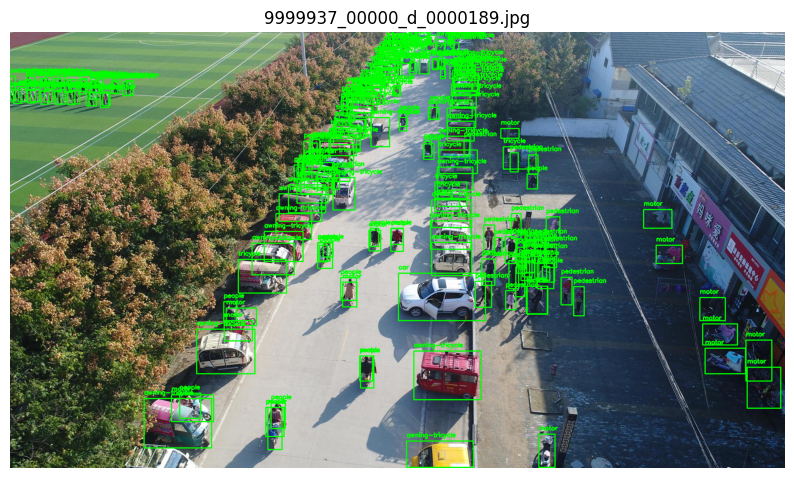

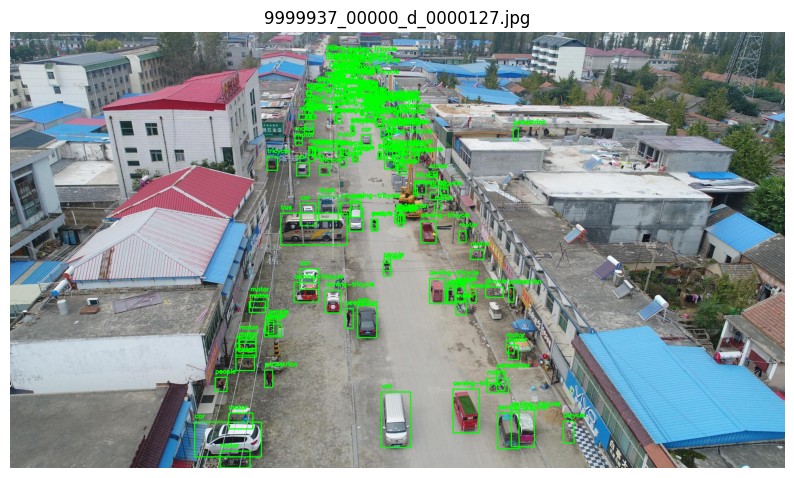

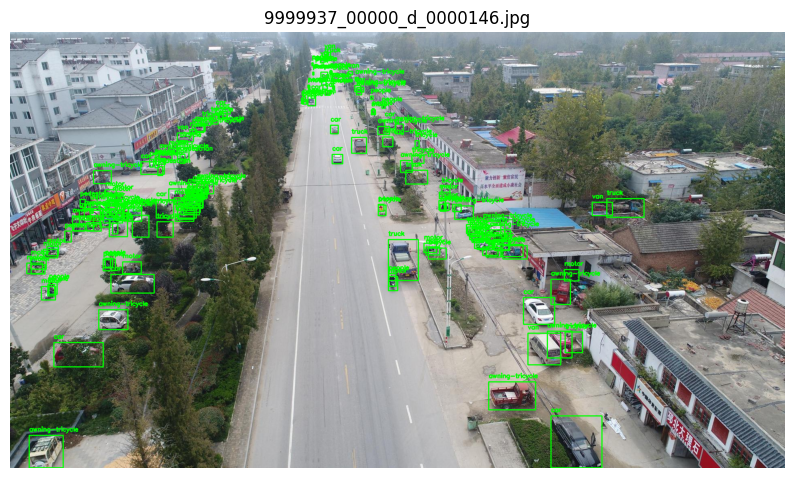

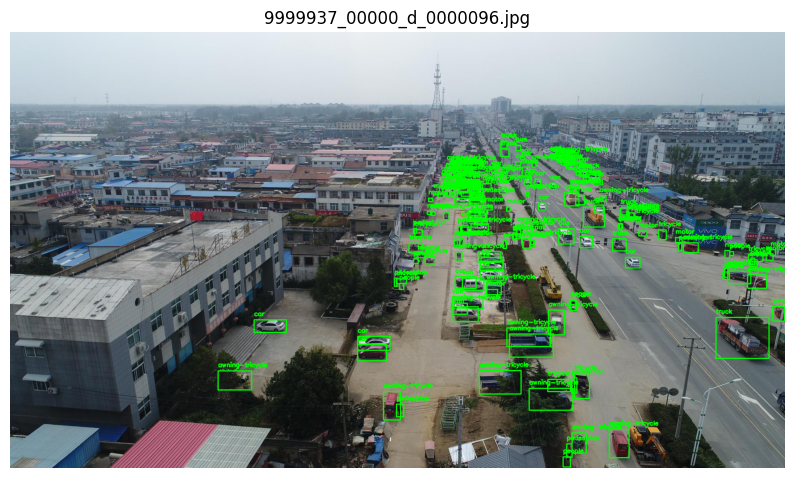

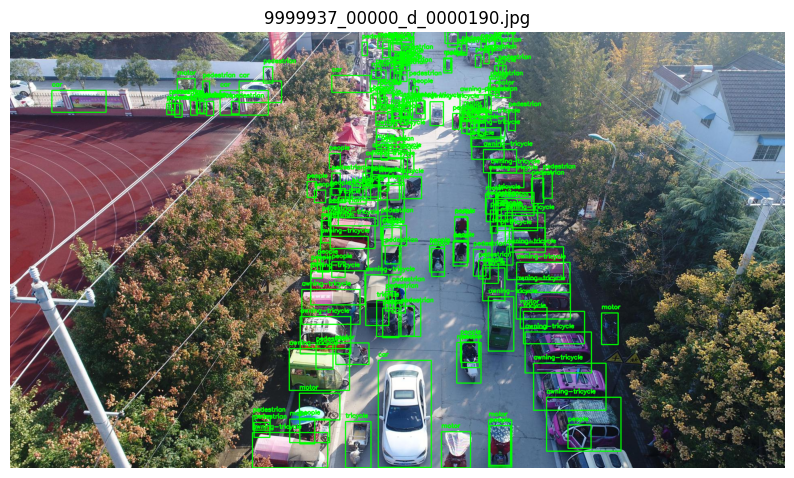

In [20]:
# Ejemplo de uso: obtener las 5 imágenes con más "awning-tricycle" (clase 7)
images_with_awning_tricycle = get_images_with_most_class(7, max_images=5)

# Mostrar las imágenes encontradas
show_images_with_bboxes(images_with_awning_tricycle, images_dir_train, labels_dir_train, df)

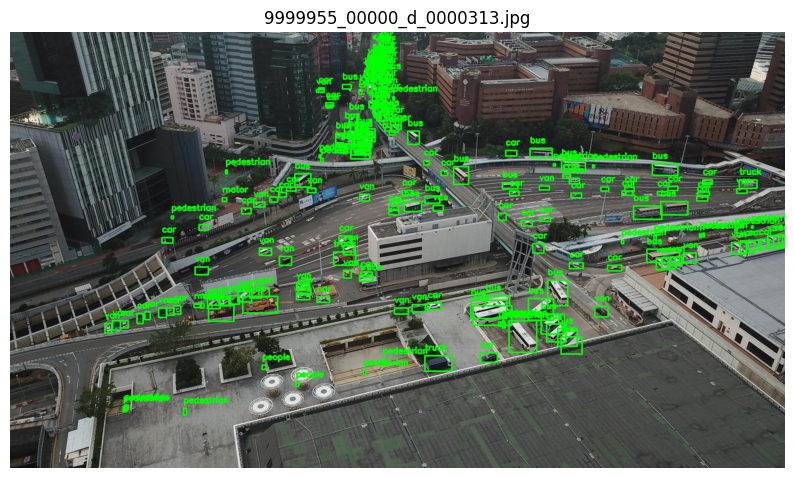

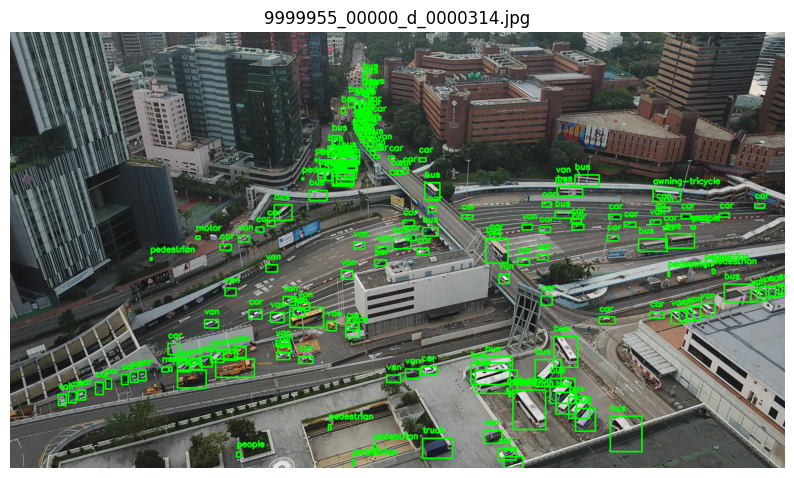

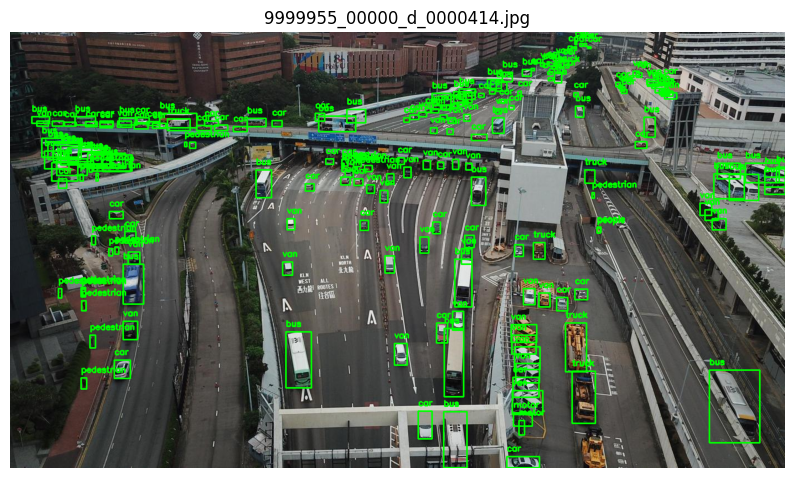

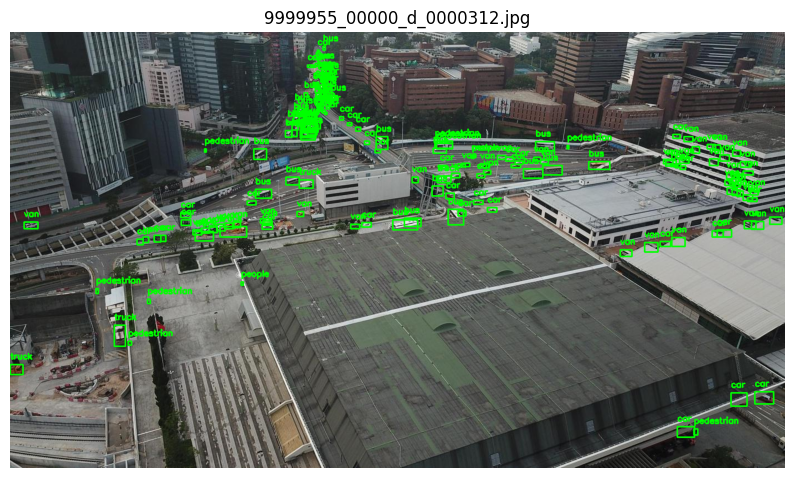

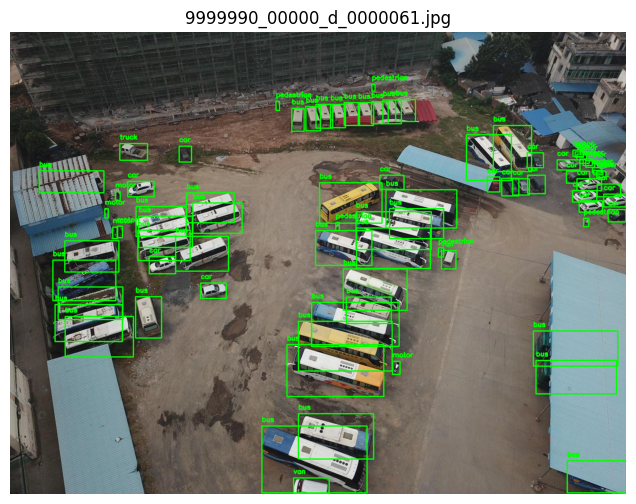

In [21]:
# Ejemplo de uso: obtener las 5 imágenes con más "bus" (clase 8)
images_with_awning_tricycle = get_images_with_most_class(8, max_images=5)

# Mostrar las imágenes encontradas
show_images_with_bboxes(images_with_awning_tricycle, images_dir_train, labels_dir_train, df)

In [22]:
def get_images_with_highest_proportion_of_class(class_name, labels_dir, max_images=5):
  """
  Dada una clase, devuelve las imágenes que tienen mayor proporción de dicha clase respecto a las demás.

  Args:
    class_name: El nombre de la clase a buscar (e.g., 'awning-tricycle').
    max_images: El máximo de imágenes a devolver.

  Returns:
    Una lista de tuplas (image_name, proportion), donde image_name es el nombre
    de la imagen y proportion es la proporción de la clase en la imagen.
  """

  class_label = df[df['category'] == class_name]['label'].values[0]
  images_with_class_counts = {}

  for filename in os.listdir(labels_dir):
    if filename.endswith('.txt'):
      with open(os.path.join(labels_dir, filename), 'r') as file:
        total_objects = 0
        class_objects = 0
        for line in file:
          category, *_ = line.split()
          category = int(category)
          total_objects += 1
          if category == class_label:
            class_objects += 1

        if total_objects > 0:
          proportion = class_objects / total_objects
          image_name = filename.replace('.txt', '.jpg')
          images_with_class_counts[image_name] = proportion

  sorted_images = sorted(images_with_class_counts.items(), key=lambda item: item[1], reverse=True)

  return sorted_images[:max_images]


Imágenes con mayor proporción de la clase 'awning-tricycle':
- 9999937_00000_d_0000183.jpg: Proporción = 0.33
- 9999937_00000_d_0000224.jpg: Proporción = 0.26
- 9999942_00000_d_0000158.jpg: Proporción = 0.25
- 9999937_00000_d_0000219.jpg: Proporción = 0.24
- 9999937_00000_d_0000184.jpg: Proporción = 0.23


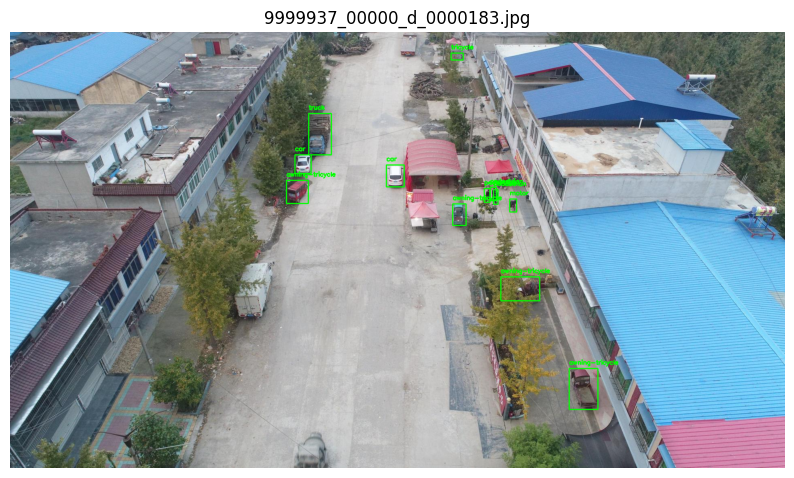

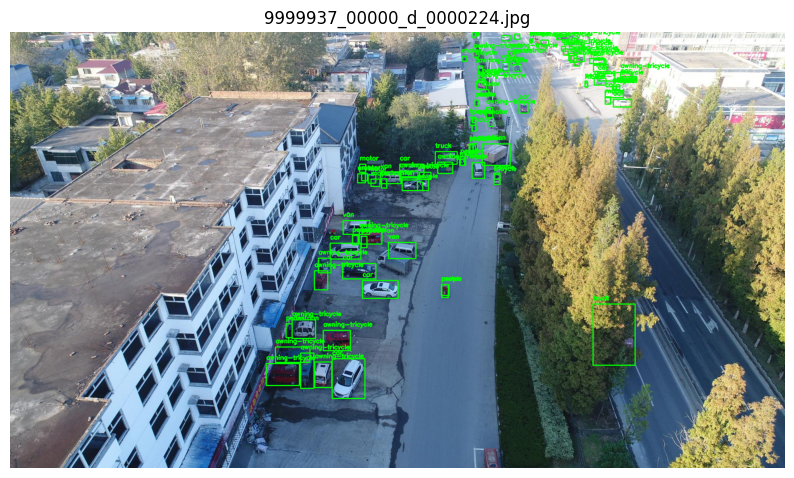

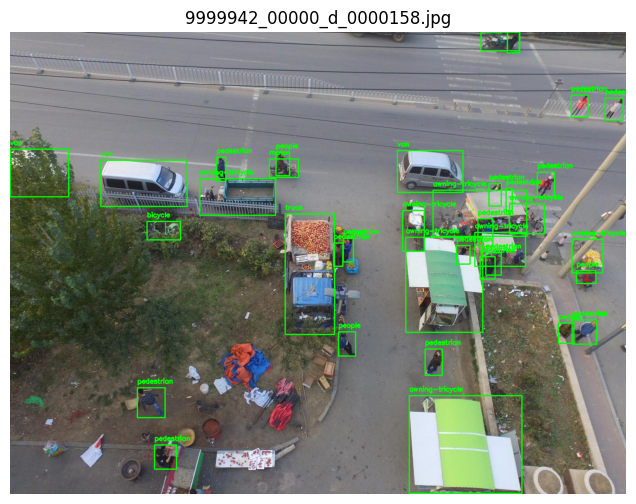

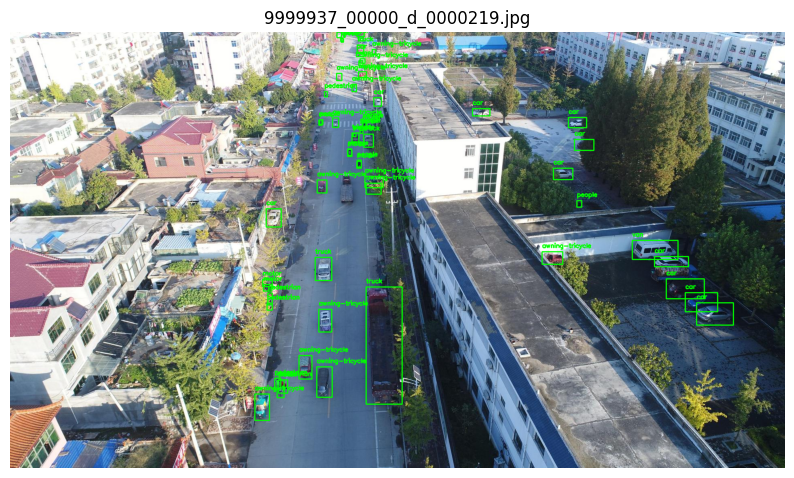

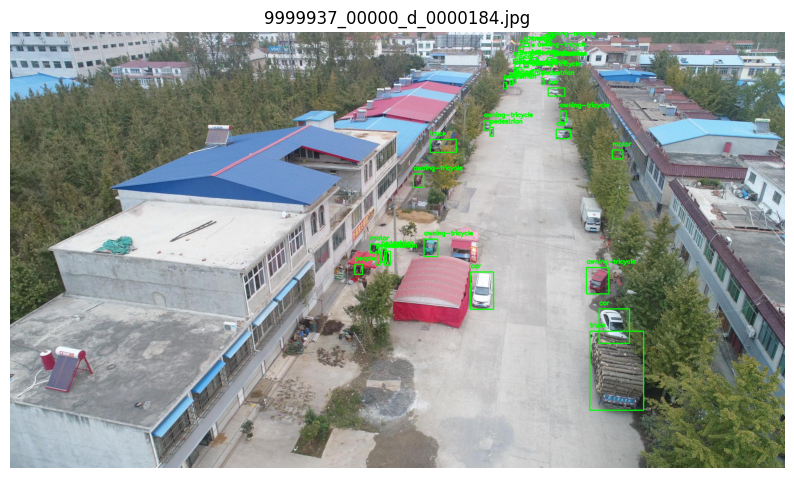

In [23]:
# Ejemplo de uso:
class_name_to_search = 'awning-tricycle'
max_images_to_return = 5
result = get_images_with_highest_proportion_of_class(class_name_to_search, labels_dir_train, max_images_to_return)

print(f"Imágenes con mayor proporción de la clase '{class_name_to_search}':")
for image_name, proportion in result:
  print(f"- {image_name}: Proporción = {proportion:.2f}")

show_images_with_bboxes([x[0] for x in result], images_dir_train, labels_dir_train, df)

Imágenes con mayor proporción de la clase 'bus':
- 9999956_00000_d_0000001.jpg: Proporción = 0.89
- 9999955_00000_d_0000120.jpg: Proporción = 0.75
- 9999955_00000_d_0000116.jpg: Proporción = 0.71
- 9999955_00000_d_0000118.jpg: Proporción = 0.70
- 9999951_00000_d_0000297.jpg: Proporción = 0.67


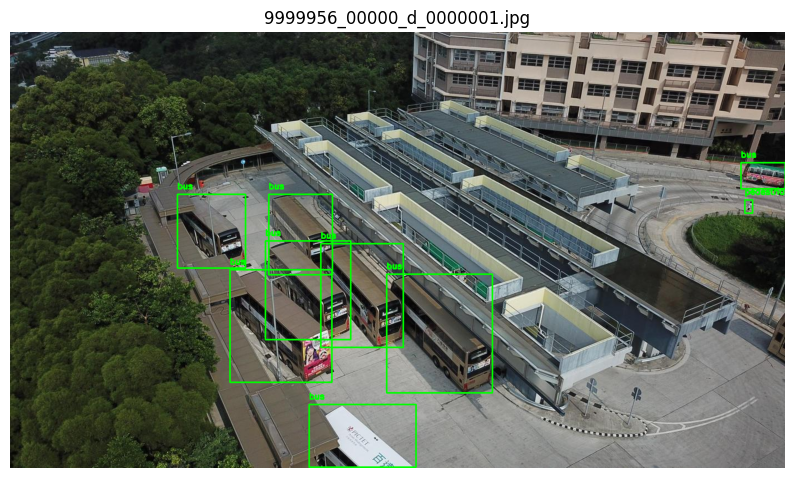

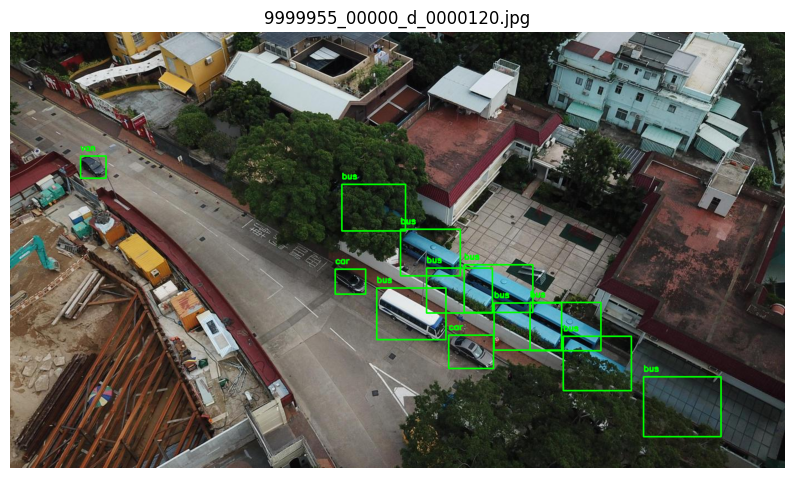

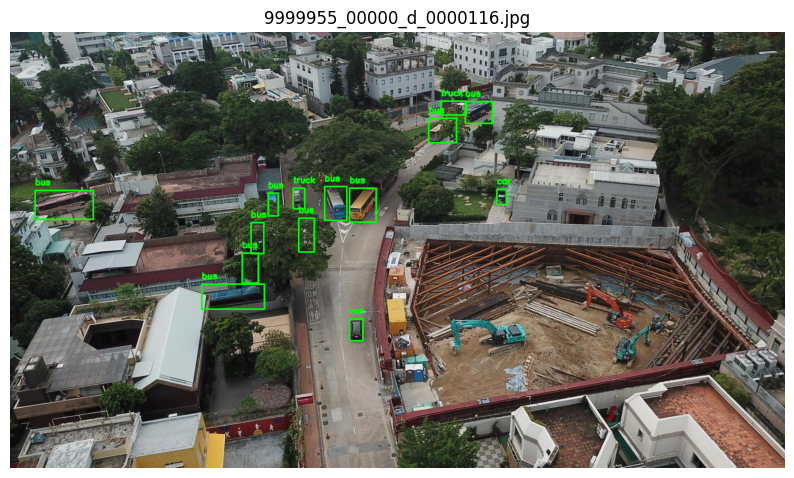

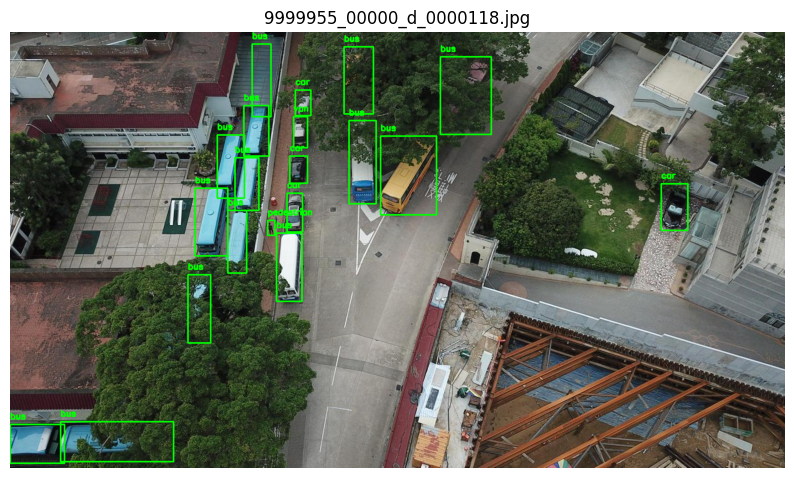

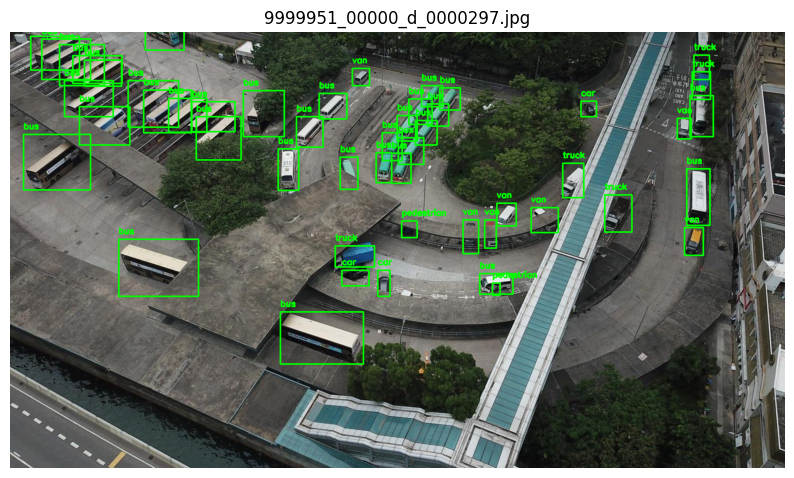

In [24]:
# Otro ejemplo de uso:
class_name_to_search = 'bus'
max_images_to_return = 5
result = get_images_with_highest_proportion_of_class(class_name_to_search, labels_dir_train, max_images_to_return)

print(f"Imágenes con mayor proporción de la clase '{class_name_to_search}':")
for image_name, proportion in result:
  print(f"- {image_name}: Proporción = {proportion:.2f}")

show_images_with_bboxes([x[0] for x in result], images_dir_train, labels_dir_train, df)

# Preprocesamiento
Filtrado según area del label en la imágen

In [25]:
def bounding_box_areas(image_file, images_dir, labels_dir):
  """
  Calcula el área de cada bounding box en una imagen y la asocia a su clase.

  Args:
    image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
    images_dir: El directorio donde se encuentra la imagen.
    labels_dir: El directorio donde se encuentra el archivo de etiquetas.

  Returns:
    Un diccionario donde las claves son los IDs de clase y los valores son
    listas de áreas de bounding boxes para esa clase.
  """

  image_path = os.path.join(images_dir, image_file)
  label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

  areas = {}
  if os.path.exists(label_path):
    with open(label_path, 'r') as f:
      for line in f:
        class_id, x_center, y_center, width, height, *_ = line.strip().split()
        class_id = int(class_id)
        area = float(width) * float(height)
        if class_id not in areas:
          areas[class_id] = []
        areas[class_id].append(area)
  return areas

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'  # Reemplazar con el nombre de tu imagen
images_dir = 'VisDrone2019-DET-train/images'  # Reemplazar con la ruta a tus imágenes
labels_dir = 'VisDrone2019-DET-train/labels'  # Reemplazar con la ruta a tus etiquetas

areas = bounding_box_areas(image_file, images_dir, labels_dir)

print(f"Áreas de las bounding boxes en {image_file}:")
for class_id, areas_list in areas.items():
  for i, area in enumerate(areas_list):
    print(f"  Clase {class_id}, Bounding box {i+1}: {area}")

Áreas de las bounding boxes en 9999937_00000_d_0000219.jpg:
  Clase 3, Bounding box 1: 0.0024231949000000003
  Clase 3, Bounding box 2: 0.0018204326459999999
  Clase 3, Bounding box 3: 0.002230067755
  Clase 3, Bounding box 4: 0.0010167166309999998
  Clase 3, Bounding box 5: 0.000650700648
  Clase 3, Bounding box 6: 0.0006042291880000001
  Clase 3, Bounding box 7: 0.000544663826
  Clase 3, Bounding box 8: 0.00037475321400000003
  Clase 3, Bounding box 9: 0.000806118384
  Clase 3, Bounding box 10: 0.000183023995
  Clase 3, Bounding box 11: 9.586658e-05
  Clase 3, Bounding box 12: 7.4558367e-05
  Clase 3, Bounding box 13: 5.325467599999999e-05
  Clase 4, Bounding box 1: 0.002571338223
  Clase 4, Bounding box 2: 6.390765200000001e-05
  Clase 7, Bounding box 1: 0.000765453826
  Clase 7, Bounding box 2: 0.001379841309
  Clase 7, Bounding box 3: 0.0008705325399999999
  Clase 7, Bounding box 4: 0.00084051864
  Clase 7, Bounding box 5: 0.0011329203330000001
  Clase 7, Bounding box 6: 0.0003718

In [26]:
def filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en un umbral de área.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de área.
    """

    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

    filtered_lines = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if area >= area_threshold:
                    filtered_lines.append(line)
    return filtered_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
area_threshold = 0.001  # Puedes ajustar este valor

filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

print(f"Labels filtrados para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Labels filtrados para 9999937_00000_d_0000219.jpg:
3 0.909447 0.647032 0.047495 0.051020
3 0.892484 0.620130 0.041754 0.043599
3 0.871086 0.590445 0.049061 0.045455
4 0.832724 0.501391 0.058977 0.043599
3 0.853862 0.528293 0.043841 0.023191
5 0.482516 0.720315 0.046451 0.268089
7 0.406054 0.803803 0.019833 0.069573
7 0.325157 0.860390 0.018789 0.060297
5 0.404749 0.544527 0.021399 0.053803


# Nuevo dataset
Se va a armar un nuevo dataset filtrando los labels que ocupen un area muy pequeña en realacion a la imagen.

In [27]:
import os
import shutil
import random
from shutil import copyfile

In [28]:
def filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold=0.001, num_images=50):
    """
    Selecciona imágenes aleatorias, filtra las bounding boxes por área y guarda las imágenes y
    labels filtrados en un nuevo directorio.

    Args:
      images_dir: Directorio de imágenes.
      labels_dir: Directorio de etiquetas.
      output_dir: Directorio de salida.
      area_threshold: Umbral de área para filtrar bounding boxes.
      num_images: Número de imágenes a seleccionar.
    """
    # Crea el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'labels'), exist_ok=True)

    # Selecciona imágenes aleatorias
    image_files = random.sample(os.listdir(images_dir), num_images)

    for image_file in image_files:
        # Copia la imagen al directorio de salida
        image_path = os.path.join(images_dir, image_file)
        output_image_path = os.path.join(output_dir, 'images', image_file)
        copyfile(image_path, output_image_path)

        # Filtra las bounding boxes
        label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
        filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

        # Guarda las etiquetas filtradas
        if len(filtered_labels) > 0: # no se guardan los .txt sin labels
            output_label_path = os.path.join(output_dir, 'labels', image_file.replace('.jpg', '.txt'))
            with open(output_label_path, 'w') as f:
                for line in filtered_labels:
                    f.write(line)


In [29]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
output_dir = 'VisDrone-AreaFilter-train'
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [30]:
def delete_images_without_labels(images_dir, labels_dir):
  """
  Elimina las imágenes que no tienen un archivo de etiquetas correspondiente.

  Args:
    images_dir: Directorio de imágenes.
    labels_dir: Directorio de etiquetas.
  """
  for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg'):
      label_file = image_file.replace('.jpg', '.txt')
      label_path = os.path.join(labels_dir, label_file)
      if not os.path.exists(label_path):
        image_path = os.path.join(images_dir, image_file)
        os.remove(image_path)
        print(f"Imagen eliminada: {image_file}")

In [31]:
# Ejemplo de uso
delete_images_without_labels(images_dir, labels_dir)

In [32]:
#!rm -rf /content/VisDrone-AreaFilter-train

## Visualización de las clases

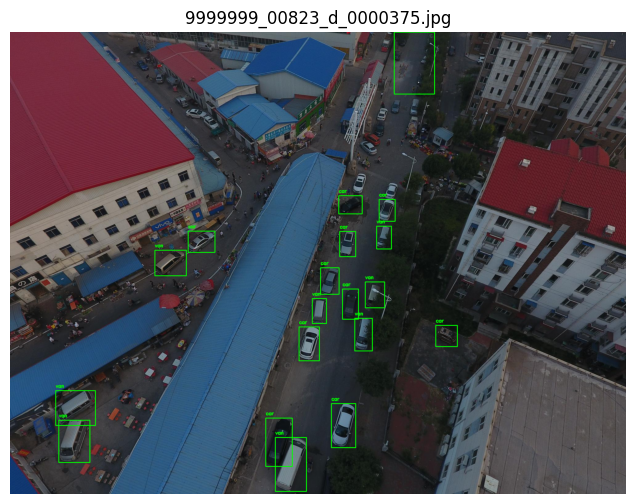

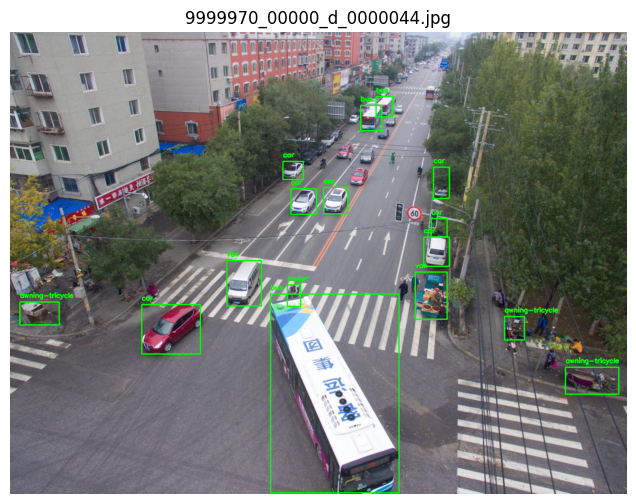

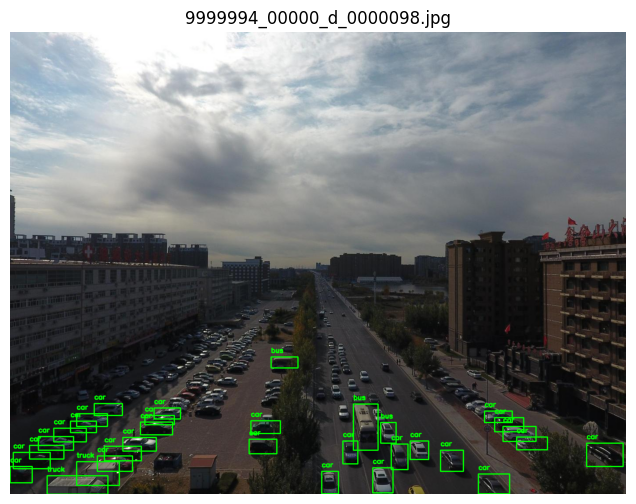

In [33]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df)

Repetimos proceso para dataset de validacion

In [34]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-val/images'
labels_dir = 'VisDrone2019-DET-val/labels'
output_dir = 'VisDrone-AreaFilter-val'
area_threshold = 0.001
num_images = 50

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [35]:
delete_images_without_labels(images_dir, labels_dir)

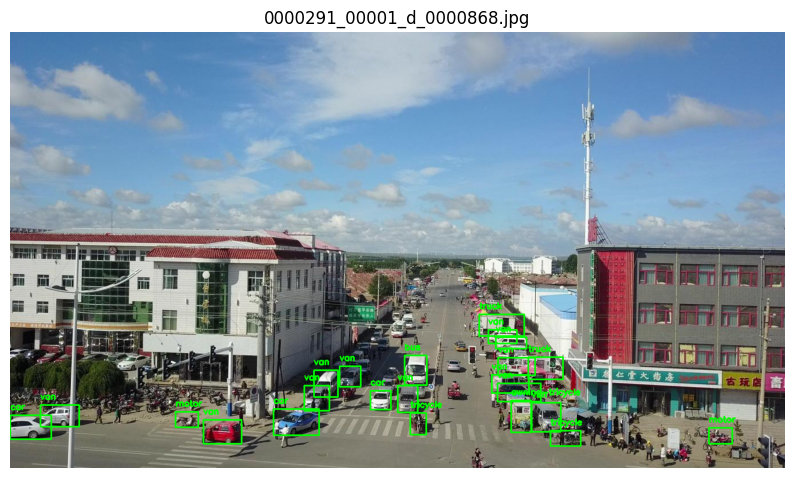

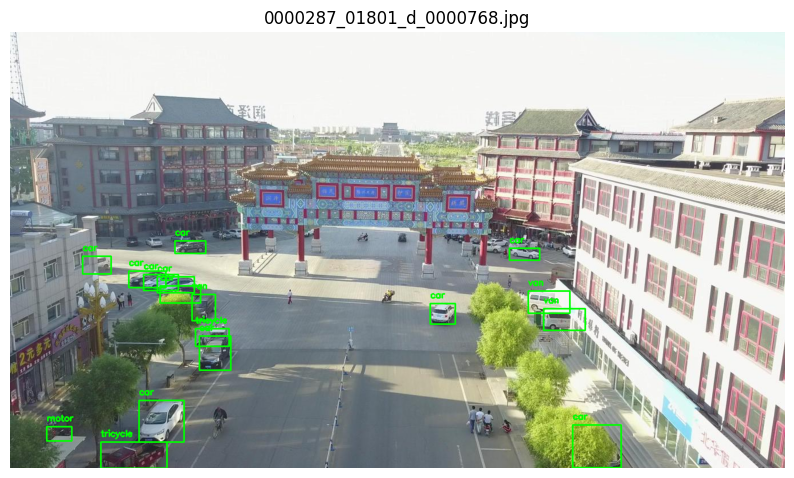

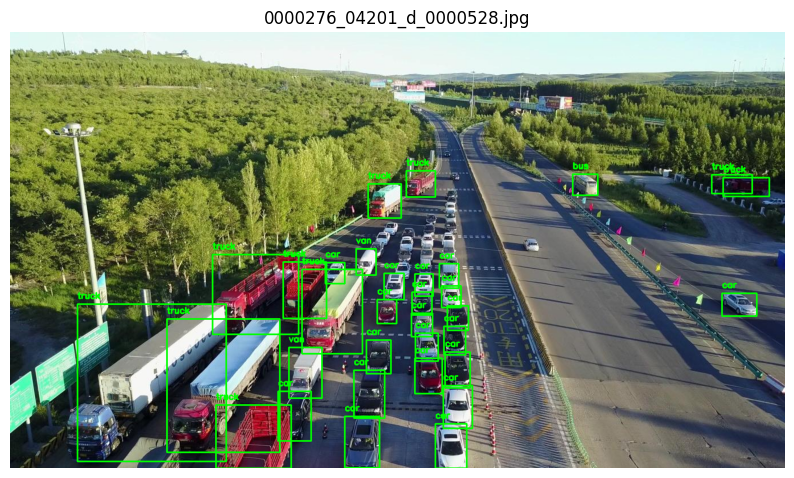

In [36]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df)

Listo, ahora tenemos un nuevo dataset mas pequeño enfocado a objetos de gran tamaño.

## Nuevo balance de clases:

Cantidad de imagenes: 485


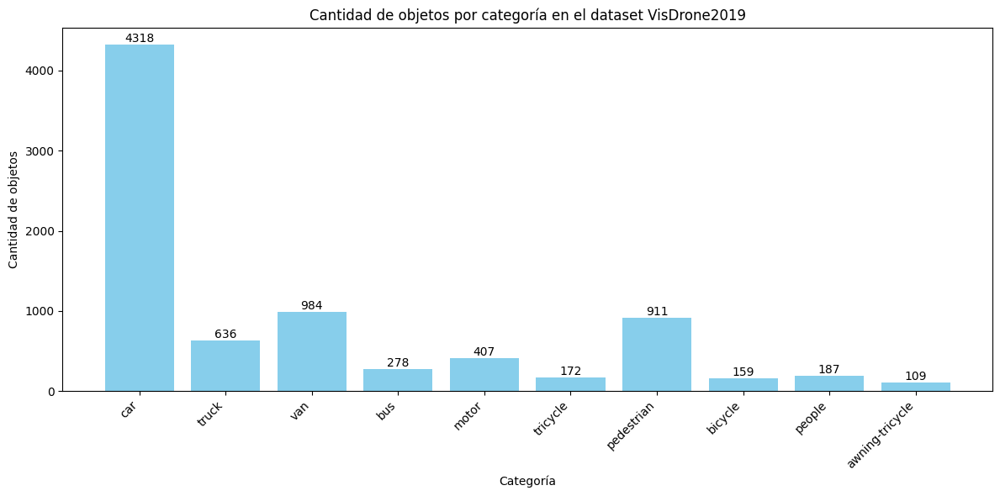

In [37]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

---

# Entrenamiento N 1

In [38]:
%%writefile data.yaml
train: ../../VisDrone-AreaFilter-train/images     #../../VisDrone2019-DET-train/images
val: ../../VisDrone-AreaFilter-val/images         # ../../VisDrone2019-DET-val/images

nc: 10
names: ['pedestrian', 'people', 'bicycle', 'car', 'van', 'truck', 'tricycle', 'awning-tricycle', 'bus', 'motor']


Writing data.yaml


In [39]:
# Se carga tensorboard para el próximo entrenamiento
# Ajustar directorio en caso que no sea la primera ejecución (podría ser train2, train3, ...)

%load_ext tensorboard
%tensorboard --logdir runs/detect/train

<IPython.core.display.Javascript object>

In [40]:
# Cargar el modelo YOLOv8
model = YOLO('yolov8s.pt')

# Entrenar el modelo congelando las primeras 10 capas (hasta el bloque SPPF)
results = model.train(
    data='data.yaml',
    imgsz=640,
    batch=16,
    epochs=50,
    freeze=10,  # Congela las primeras 10 capas (backbone completo)
    auto_augment=False, # Desactivar auto augmentation
    mosaic=0,          # Desactivar mosaic
    hsv_h=0,           # No variación en matiz
    hsv_s=0,           # No variación en saturación
    hsv_v=0,           # No variación en brillo
    degrees=0,         # Sin rotación
    translate=0,       # Sin traslación
    scale=0,           # Sin escalado
    shear=0,           # Sin corte
    flipud=0,          # No flip vertical
    fliplr=0,          # No flip horizontal
    copy_paste=0       # Desactivar Copy-Paste
)


100%|██████████| 21.5M/21.5M [00:00<00:00, 236MB/s]


Ultralytics 8.3.1 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None,

100%|██████████| 755k/755k [00:00<00:00, 58.2MB/s]


Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytic

train: Scanning /content/VisDrone-AreaFilter-train/labels... 485 images, 15 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<00:00, 890.10it/s]

train: New cache created: /content/VisDrone-AreaFilter-train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.17 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/VisDrone-AreaFilter-val/labels... 49 images, 1 backgrounds, 0 corrupt: 100%|██████████| 50/50 [00:00<00:00, 1973.38it/s]

val: New cache created: /content/VisDrone-AreaFilter-val/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 63 weight(decay=0.0), 70 weight(decay=0.0005), 69 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      1.468      4.187      1.062         76        640: 100%|██████████| 32/32 [11:28<00:00, 21.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.16s/it]

                   all         50       1252     0.0212      0.102     0.0288     0.0125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G      1.424      2.701      1.004         88        640: 100%|██████████| 32/32 [10:51<00:00, 20.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00:00, 10.97s/it]

                   all         50       1252     0.0129      0.122     0.0305     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G      1.282       2.01     0.9706         77        640: 100%|██████████| 32/32 [10:45<00:00, 20.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.97s/it]

                   all         50       1252       0.03        0.3      0.106     0.0659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G       1.18       1.75     0.9472         56        640: 100%|██████████| 32/32 [10:44<00:00, 20.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.19s/it]

                   all         50       1252      0.646     0.0909      0.148     0.0866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      1.102      1.597     0.9255         16        640: 100%|██████████| 32/32 [11:00<00:00, 20.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.03s/it]

                   all         50       1252      0.464      0.145      0.174      0.103



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      1.045      1.477      0.911         41        640: 100%|██████████| 32/32 [10:46<00:00, 20.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00:00, 10.94s/it]

                   all         50       1252       0.41      0.179       0.17      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G      1.009      1.441     0.9062        206        640:  44%|████▍     | 14/32 [04:51<06:15, 20.85s/it]


KeyboardInterrupt: 

## Predicción

In [ ]:
def predict_and_show_images_comparison(image_files, model, images_dir, labels_dir, df, confidence_threshold=0.5):
  """
  Realiza predicciones con el modelo YOLO en un conjunto de imágenes y muestra las imágenes con las bounding boxes, comparando
  la predicción con las etiquetas reales.

  Args:
    image_files: Una lista de nombres de archivos de imágenes.
    model: El modelo YOLO a utilizar para las predicciones.
    images_dir: El directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
    confidence_threshold: El umbral de confianza para las predicciones.
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Realizar la predicción
      results = model(image_path)

      # Obtener la primera predicción (si hay más de una)
      predicted_image = cv2.imread(image_path)
      predicted_image = cv2.cvtColor(predicted_image, cv2.COLOR_BGR2RGB)
      if results and results[0].boxes:
          boxes = results[0].boxes.xywh.cpu().numpy()  # Coordenadas de las bounding boxes
          confidence = results[0].boxes.conf.cpu().numpy()
          class_ids = results[0].boxes.cls.cpu().numpy().astype(int)

          for box, conf, cls_id in zip(boxes, confidence, class_ids):
              if conf >= confidence_threshold:
                  x_center, y_center, width, height = box
                  x_min = int(x_center - width / 2)
                  y_min = int(y_center - height / 2)
                  x_max = int(x_center + width / 2)
                  y_max = int(y_center + height / 2)

                  # Dibujar la bounding box
                  cv2.rectangle(predicted_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == cls_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(predicted_image, f"{category}: {conf:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)


      # Cargar la imagen real con las bounding boxes reales
      real_image = cv2.imread(image_path)
      real_image = cv2.cvtColor(real_image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = real_image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(real_image, (x_min, y_min), (x_max, y_max), (0, 0, 255), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(real_image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


      # Combinar las imágenes lado a lado
      combined_image = np.concatenate((predicted_image, real_image), axis=1)

      # Mostrar la imagen combinada
      plt.figure(figsize=(15, 6))
      plt.imshow(combined_image)
      plt.title(f"Predicción vs. Real - {image_file}")
      plt.axis('off')
      plt.show()


In [ ]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone-AreaFilter-train/images'
labels_dir_train = 'VisDrone-AreaFilter-train/labels'

images_dir_val = 'VisDrone-AreaFilter-val/images'
labels_dir_val = 'VisDrone-AreaFilter-val/labels'

In [ ]:
# Ejemplos en validación
image_files_to_predict = random.sample(os.listdir(images_dir_val), 10)

# Realizar predicciones y mostrar las imágenes con las bounding boxes
predict_and_show_images_comparison(image_files_to_predict, model, images_dir_val, labels_dir_val, df)

# Entrenamiento N 2

- Chequeo de la resolución original

In [ ]:
import cv2

In [ ]:
# tamaño de las imagenes
img_path = "/content/VisDrone-AreaFilter-val/images/0000001_03999_d_0000007.jpg"
img = cv2.imread(img_path)
if img is not None:
    height, width, channels = img.shape
    print(f"Image: {filename}, Size: {width}x{height}")

- Prueba con hiperparametros distintos:

    - imgsz=1080
    - freeze=16
    - epochs=20

- Usamos el modelo YOLOv8 tamaño M

In [ ]:
# Cargar el modelo YOLOv8
model_2 = YOLO('yolov8m.pt')

# Entrenar el modelo congelando las primeras 10 capas (hasta el bloque SPPF)
results_2 = model_2.train(
    data='data.yaml',
    imgsz=1080,
    batch=16,
    epochs=20,
    freeze=16,  # Congela las primeras 16 capas
    auto_augment=False, # Desactivar auto augmentation
    mosaic=0,          # Desactivar mosaic
    hsv_h=0,           # No variación en matiz
    hsv_s=0,           # No variación en saturación
    hsv_v=0,           # No variación en brillo
    degrees=0,         # Sin rotación
    translate=0,       # Sin traslación
    scale=0,           # Sin escalado
    shear=0,           # Sin corte
    flipud=0,          # No flip vertical
    fliplr=0,          # No flip horizontal
    copy_paste=0       # Desactivar Copy-Paste
)


## Predicción

In [ ]:
# Ejemplos en validación
image_files_to_predict = random.sample(os.listdir(images_dir_val), 10)

# Realizar predicciones y mostrar las imágenes con las bounding boxes
predict_and_show_images_comparison(image_files_to_predict, model_2, images_dir_val, labels_dir_val, df)

In [ ]:
from google.colab import files

# Save the model to a file (e.g., 'best.pt')
model_2.save('model_2.pt')

# Download the saved model to your local machine
files.download('model_2.pt')

# Entrenamiento N 3

## Eliminamos algunas clases

Se van a eliminar las clases menos representativas, de peor calidad de imagen y que resultaron teniendo un mal rendimiento. El problema se va a enfocar solamente a vehículos de "gran" porte.

In [ ]:
def delete_specific_labels(labels_dir, labels_to_delete):
    """
    Deletes specific labels from annotation files in a directory.

    Args:
        labels_dir: The directory containing the annotation files.
        labels_to_delete: A list of labels to delete.
    """
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            with open(filepath, 'r') as f:
                lines = f.readlines()

            filtered_lines = [line for line in lines if line.split()[0] not in labels_to_delete]

            with open(filepath, 'w') as f:
                f.writelines(filtered_lines)

In [ ]:
df

In [ ]:
# Specify the labels to delete (corresponding class IDs from label_map.txt)
labels_to_delete = ['1', '2', '6', '7']  # people, bicycle, tricycle, awning-tricycle

# Specify the directories for train and validation datasets
train_labels_dir = 'VisDrone-AreaFilter-train/labels'
val_labels_dir = 'VisDrone-AreaFilter-val/labels'

# Delete the labels from the datasets
delete_specific_labels(train_labels_dir, labels_to_delete)
delete_specific_labels(val_labels_dir, labels_to_delete)


- Chequeo balanceo de clases

In [ ]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

In [ ]:
def remap_class_ids(labels_dir, class_id_mapping):
    """
    Remaps class IDs in annotation files according to a mapping.

    Args:
        labels_dir: The directory containing the annotation files.
        class_id_mapping: A dictionary mapping old class IDs to new class IDs.
    """
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            with open(filepath, 'r') as f:
                lines = f.readlines()

            updated_lines = []
            for line in lines:
                parts = line.strip().split()
                old_class_id = int(parts[0])
                if old_class_id in class_id_mapping:
                    new_class_id = class_id_mapping[old_class_id]
                    parts[0] = str(new_class_id)
                    updated_lines.append(' '.join(parts) + '\n')

            with open(filepath, 'w') as f:
                f.writelines(updated_lines)

In [ ]:
# Buscamos evitar que yolo ignore las clases cuyo id supere el numero total de clases.

class_id_mapping = {
    0: 0,  # pedestrian remains 0
    3: 1,  # car becomes 1
    4: 2,  # van becomes 2
    5: 3,  # truck becomes 3
    8: 4,  # bus becomes 4
    9: 5   # motor becomes 5
}
remap_class_ids(train_labels_dir, class_id_mapping)
remap_class_ids(val_labels_dir, class_id_mapping)

print("Class IDs remapped in the datasets.")

In [ ]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['label'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

In [ ]:
%%writefile data.yaml
train: ../../VisDrone-AreaFilter-train/images
val: ../../VisDrone-AreaFilter-val/images

nc: 6
names: ['pedestrian', 'car', 'van', 'truck', 'bus', 'motor']


## Entrenamos

In [ ]:
# Cargar el modelo YOLOv8
model_3 = YOLO('yolov8m.pt')

# Entrenar el modelo congelando las primeras 10 capas (hasta el bloque SPPF)
results_3 = model_3.train(
    data='data.yaml',
    imgsz=1080,
    batch=16,
    epochs=22,
    freeze=16,  # Congela las primeras 16 capas
    auto_augment=False, # Desactivar auto augmentation
    mosaic=0,          # Desactivar mosaic
    hsv_h=0,           # No variación en matiz
    hsv_s=0,           # No variación en saturación
    hsv_v=0,           # No variación en brillo
    degrees=0,         # Sin rotación
    translate=0,       # Sin traslación
    scale=0,           # Sin escalado
    shear=0,           # Sin corte
    flipud=0,          # No flip vertical
    fliplr=0,          # No flip horizontal
    copy_paste=0      # Desactivar Copy-Paste

)


## Predicción

In [ ]:
# Ejemplos en validación
image_files_to_predict = random.sample(os.listdir(images_dir_val), 10)

# Realizar predicciones y mostrar las imágenes con las bounding boxes
predict_and_show_images_comparison(image_files_to_predict, model_3, images_dir_val, labels_dir_val, df)

In [ ]:
# Save the model to a file (e.g., 'best.pt')
model_3.save('model_3.pt')

# Download the saved model to your local machine
files.download('model_3.pt')

# Tuneo de Hiperparámetros

In [ ]:
import pandas as pd
!pip install -U "ray[tune]"

AttributeError: 'NoneType' object has no attribute 'system'

In [ ]:
from ray import tune

ModuleNotFoundError: No module named 'ray'

## Hiperparámetros de augmentation

In [ ]:
# Define the hyperparameter search space for scenario 1
scenario1_space = {
    "crop_fraction": tune.uniform(0.1, 1.0),
    "auto_augment": tune.choice(["randaugment", None]),  # Use None to disable
    "mosaic": tune.uniform(0.0, 1.0),
    "hsv_v": tune.uniform(0.0, 1.0),
    "hsv_s": tune.uniform(0.0, 1.0),
    "hsv_h": tune.uniform(0.0, 1.0),
}

# Define a function to train and evaluate the model with given hyperparameters
def train_and_evaluate(config):
    model = YOLO("yolov8m.pt")  # Load your model

    # Update training settings based on config
    model.train(data="data.yaml",
                #imgsz=1080,
                batch=16,
                epochs=20,
                freeze=16,
                **config)

    # Evaluate the model
    metrics = model.val()
    return {"mAP50-95": metrics.box.map5095}  # Use your desired metric

# Start the hyperparameter search for scenario 1
analysis = tune.run(
    train_and_evaluate,
    config=scenario1_space,
    num_samples=10,  # Number of trials
    resources_per_trial={"cpu": 4, "gpu": 1},
)

# Print the best hyperparameters and results
best_config_1 = analysis.get_best_config(metric="mAP50-95", mode="max")
print(f"Best hyperparameters for Scenario 1: {best_config_1}")
print(f"Best mAP50-95: {analysis.get_best_trial().best_result['mAP50-95']}")

- Diccionario de parametros actualizado:

In [ ]:
# Define the variation percentage
variation_percentage = 0.05  # 5% variation

# Create a new configuration dictionary with variations
config_with_variations_1 = {}
for param_name, best_value in best_config_1.items():
    if param_name in scenario1_space:
        if isinstance(scenario1_space[param_name], tune.sample.Float):  # For Float parameters
            lower_bound = best_value * (1 - variation_percentage)
            upper_bound = best_value * (1 + variation_percentage)
            config_with_variations_1[param_name] = tune.uniform(lower_bound, upper_bound)
        elif isinstance(scenario1_space[param_name], tune.sample.Categorical):  # For Categorical parameters
            config_with_variations_1[param_name] = scenario1_space[param_name]  # Keep the same choices
        # Add more checks for other types if needed

print("Configuration with variations:")
print(config_with_variations_1)

## Hiperparámetros de configuracion del entrenamiento

In [ ]:
scenario2_space = {
    "imgsz": tune.choice([640, 920, 1080]),  # Randomly choose between two sizes
    "pretrained": tune.choice([True, False]),
    "lr0": tune.loguniform(1e-4, 1e-2), # Randomly sample from a log-uniform distribution between 1e-4 and 1e-2
    "momentum": tune.uniform(0.8, 0.99),  # Default 0.937
    "weight_decay": tune.loguniform(1e-5, 1e-3), # Default 0.0005
    "warmup_bias_lr": tune.uniform(0.05, 0.2),   # Default 0.1
    "kobj": tune.uniform(1.0, 3.0),  # Default 2.0
    "dropout": tune.uniform(0.0, 0.6),
}

In [ ]:
# Start the hyperparameter search for scenario 1
analysis = tune.run(
    train_and_evaluate,
    config=scenario2_space,
    num_samples=10,  # Number of trials
    resources_per_trial={"cpu": 4, "gpu": 1},
)

# Print the best hyperparameters and results
best_config_2 = analysis.get_best_config(metric="mAP50-95", mode="max")
print(f"Best hyperparameters for Scenario 1: {best_config_2}")
print(f"Best mAP50-95: {analysis.get_best_trial().best_result['mAP50-95']}")

## Tuneo conjunto
- Utilizando los mejores parámetros de cada escenario.

In [ ]:
# Combinar los dos diccionarios de configuración
combined_config = {**config_with_variations_1, **best_config_2} # ** se usa para desempaquetar los diccionarios y combinarlos en uno solo.

# Iniciar la búsqueda de hiperparámetros con la configuración combinada
analysis = tune.run(
    train_and_evaluate,
    config=combined_config,
    num_samples=10,  # Número de pruebas
    resources_per_trial={"cpu": 4, "gpu": 1},
)

In [ ]:
# Print the best hyperparameters and results
final_config = analysis.get_best_config(metric="mAP50-95", mode="max")
print(f"Best hyperparameters: {final_config}")
print(f"Best mAP50-95: {analysis.get_best_trial().best_result['mAP50-95']}")